In [211]:

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import sys
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder

from catboost import CatBoostRegressor, Pool

from tqdm.notebook import tqdm

from joblib import Parallel, delayed
from bs4 import BeautifulSoup  as bs
from pprint import pprint  
import requests  
import json
from ast import literal_eval
import json

import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
from sklearn.preprocessing import StandardScaler

import my_func
import importlib
importlib.reload(my_func)

from IPython.display import Audio
from russian_names import RussianNames

In [212]:
!pip freeze > requirements.txt
RANDOM_SEED = 42

In [213]:
def mape(y_true, y_pred):
    return np.mean(np.abs((y_pred-y_true)/y_true))

In [214]:
pd.set_option('float_format', '{:f}'.format)
pd.set_option('display.max_colwidth', 100)

In [215]:
input_folder = 'data_versions/' 

In [216]:
train = pd.read_csv(input_folder + 'parsed_data_1.csv')
train.dropna(subset=['price'], inplace=True)


# print(data.sell_id.value_counts())
larry_data = pd.read_csv(input_folder + 'auto_ru.csv')
larry_data.drop(['complectation_dict',
                'image',
                'model_info',
                'name',
                'vehicleConfiguration',
                'vendor'], 
                axis=1, inplace=True)
larry_data.drop_duplicates(subset ="sell_id", keep = 'last', inplace = True)
larry_data = larry_data.drop(larry_data[larry_data.enginePower=='undefined N12'].index)
larry_data = larry_data.drop(larry_data[larry_data.price.isna()].index)
larry_data['sell_id'] = larry_data['sell_id'].str.replace('№ ', '')
larry_data

train = train.append(larry_data, sort=False).reset_index(drop=True) # объединяем

# Почистим от дубликатов
print('Размер до очистки от дублей', train.shape)
train.drop_duplicates(subset ="sell_id", keep = 'last', inplace = True)
print('Размер после очистки от дублей', train.shape)

test = pd.read_csv('kaggle/test.csv')

sample_submission = pd.read_csv('kaggle/sample_submission.csv')

Размер до очистки от дублей (175801, 29)
Размер после очистки от дублей (174867, 29)


In [217]:
# CATBOOST
ITERATIONS = 5000
LR         = 0.1

In [218]:
df_train = train
df_test = test
# ВАЖНО! дря корректной обработки признаков объединяем трейн и тест в один датасет
df_train['sample'] = 1 # помечаем где у нас трейн
df_test['sample'] = 0 # помечаем где у нас тест

data = df_test.append(df_train, sort=False).reset_index(drop=True) # объединяем
data.columns = ['bodyType', 'brand', 'car_url', 'color', 'complectation_dict',
       'description', 'engineDisplacement', 'enginePower', 'equipment_dict',
       'fuelType', 'image', 'mileage', 'modelDate', 'model_info', 'model_name',
       'name', 'numberOfDoors', 'parsing_unixtime', 'priceCurrency',
       'productionDate', 'sell_id', 'super_gen', 'vehicleConfiguration',
       'vehicleTransmission', 'vendor', 'owners', 'owning', 'pts', 'privod', 'wheel', 
       'state', 'customs', 'sample', 'Unnamed: 0','seller_name', 'price']

In [219]:
print('категории','\n', train.select_dtypes(np.object).columns)
print('нумерные','\n', train._get_numeric_data().columns)

категории 
 Index(['brand', 'model_name', 'enginePower', 'car_url', 'equipment_dict',
       'bodyType', 'color', 'engineDisplacement', 'fuelType', 'priceCurrency',
       'sell_id', 'super_gen', 'vehicleTransmission', 'Владельцы', 'ПТС',
       'Владение', 'Привод', 'Руль', 'Состояние', 'Таможня', 'description',
       'seller_name'],
      dtype='object')
нумерные 
 Index(['Unnamed: 0', 'productionDate', 'mileage', 'modelDate', 'numberOfDoors',
       'parsing_unixtime', 'price', 'sample'],
      dtype='object')


In [220]:
# data.drop(data[data.duplicated(subset='sell_id', keep='first')].index, inplace=True)

# PREPROCESSING

In [221]:

data.drop('complectation_dict', axis=1, inplace=True, errors='ignore')
data.drop('image', axis=1, inplace=True, errors='ignore')
data.drop('model_info', axis=1, inplace=True, errors='ignore')
data.drop('name', axis=1, inplace=True, errors='ignore')
data.drop('vendor', axis=1, inplace=True, errors='ignore')
data.drop('Unnamed: 0', axis=1, inplace=True, errors='ignore')
data.drop('priceCurrency', axis=1, inplace=True, errors='ignore')
data.drop('vehicleConfiguration', axis=1, inplace=True, errors='ignore')
data.drop('super_gen', axis=1, inplace=True, errors='ignore')
data.drop('seller_name', axis=1, inplace=True, errors='ignore')
data['owners'] = data['owners'].astype('category').cat.codes

data['enginePower'] = data['enginePower'].apply(lambda x: int(x.replace(' N12', '')) if type(x)==str else x)
data['engineDisplacement'] = data['engineDisplacement'].apply(lambda x: pd.to_numeric(x.replace(' LTR', '')) if type(x)==str else x)

data.drop('customs', axis=1, inplace=True, errors='ignore')

# Выбросы

In [222]:
print('граница выбросов километража: ' ,my_func.outlier_treatment(data.mileage))
# Оставим значения свыше границы, но в пределах 400к,
# Остальные значения закодируем
data['mileage600'] = data['mileage'].apply(lambda x: 1 if x>600 else 0)
data['mileage'] = data['mileage'].apply(lambda x: 400_000 if x>400_000 else x)

граница выбросов километража:  (-169500.0, 402500.0)


# ПРОПУСКИ

In [223]:
mileage_proddate = data[data.mileage!=0].groupby(by='productionDate').mileage.mean().tail(50)
mask0milage = data['mileage']==0
data['mileage'].loc[mask0milage] = data.loc[mask0milage].productionDate.apply(lambda x: mileage_proddate[x])

In [224]:
# data.loc[mask0milage].productionDate.value_counts()

In [225]:
# Просто сносим пропуски, где их незначительно мало

data.dropna(subset=['bodyType'], inplace=True)
data.dropna(subset=['enginePower'], inplace=True)


In [226]:
# Заполняем 
data['color'].fillna(method='ffill', inplace=True)

data['owners'] = data['owners'] + 1 # пока будем считать, что NaN это машины без проката, 
                                    # т.е. оставим присвоенные после кодировки значения, прибавив к всему столбу 1, 
                                    # чтобы выравнить до неотрицательных по всей колонке

data['equipment_dict'].fillna('{"not_specified":true}', inplace=True)
# data['owning'].fillna('0', inplace=True)
data['pts'].fillna('0', inplace=True)

data['wheel'].fillna('not_specified', inplace=True)
data['privod'].fillna('not_specified', inplace=True)
data['state'].fillna('not_specified', inplace=True)


data.description.fillna('пусто', inplace=True)
# data['customs'].fillna('not_specified', inplace=True)

In [227]:
# Обработка даты
def str_timedelta(string):
    import re
    string = string.replace(' года', 'Y')
    string = string.replace(' лет', 'Y')
    string = string.replace(' год', 'Y')
    string = string.replace(' и ', '')
    string = string.replace(' месяца', 'm')
    string = string.replace(' месяцев', 'm')
    string = string.replace(' месяц', 'm')
    try:
        year_part = int(re.findall(r"(\d+)m", string)[-1]) / 12
        year_part = str(round(year_part, 3)) + 'y'
    except:
        year_part = 0
    td_y = pd.to_timedelta(string).days
    td_m = pd.to_timedelta(year_part).days
    td = td_y + td_m
    return td

mask = data.owning.isna()==False
data['owning'].loc[mask] = data['owning'].loc[mask].map(str_timedelta)
data['owning'].loc[mask] = pd.to_numeric(data['owning'].loc[mask])
data['owning'].fillna(0, inplace=True)


# data.drop('owning', axis=1, inplace=True, errors='ignore')

In [228]:
print('категории','\n', data.select_dtypes(np.object).columns)
print('нумерные','\n', data._get_numeric_data().columns)

категории 
 Index(['bodyType', 'brand', 'car_url', 'color', 'description',
       'equipment_dict', 'fuelType', 'model_name', 'sell_id',
       'vehicleTransmission', 'pts', 'privod', 'wheel', 'state'],
      dtype='object')
нумерные 
 Index(['engineDisplacement', 'enginePower', 'mileage', 'modelDate',
       'numberOfDoors', 'parsing_unixtime', 'productionDate', 'owners',
       'owning', 'sample', 'price', 'mileage600'],
      dtype='object')


In [229]:
cat_features_ids = ['bodyType', 'brand', 'color','descr_labels', 'fuelType', 
                    'model_name', 'vehicleTransmission',
                    'pts', 'privod', 'wheel', 'state']

# Кодирование


In [230]:
# Catboost работает с категорийными признаками в исходном виде, 
# поэтому кодировать ничего не будем

# Feature Genering

In [231]:
print('категории','\n', data.select_dtypes(np.object).columns)
print('нумерные','\n', data._get_numeric_data().columns)

категории 
 Index(['bodyType', 'brand', 'car_url', 'color', 'description',
       'equipment_dict', 'fuelType', 'model_name', 'sell_id',
       'vehicleTransmission', 'pts', 'privod', 'wheel', 'state'],
      dtype='object')
нумерные 
 Index(['engineDisplacement', 'enginePower', 'mileage', 'modelDate',
       'numberOfDoors', 'parsing_unixtime', 'productionDate', 'owners',
       'owning', 'sample', 'price', 'mileage600'],
      dtype='object')


In [232]:
data['engpower_doors'] = data['enginePower'] * data['numberOfDoors']

data['engpower_endisp'] = data['enginePower'].apply(int) * data['engineDisplacement']

data['engpower_owners'] = data['enginePower'] * data['owners']

data['prod-model-date'] = data['productionDate'] - data['modelDate']

In [233]:
data['equipment_dict'] = data.apply(lambda r: list(literal_eval(r['equipment_dict']).keys()) 
                                              if r['sample']==1 else 
                                                  list(json.loads(r['equipment_dict']).keys()), 
                                              axis=1)

In [234]:
data['car_used'] = data['car_url'].apply(lambda x: 1 if 'used' in x else 0)
mask_d = data['car_url'].str.contains('new')
data['description'].loc[mask_d] = 'реклама'
data.drop('car_url', axis=1, inplace=True, errors='ignore')

In [235]:
d_brand_price = dict(data.groupby(by='brand').price.mean())
data['brand_price'] = data['brand'].apply(lambda x: d_brand_price[x])

d_bodyType_price = dict(data.groupby(by='bodyType').price.mean())
data['body_price'] = data['bodyType'].apply(lambda x: d_bodyType_price[x])

d_model_name_price = dict(data.groupby(by='model_name').price.mean())
data['model_name_price'] = data['model_name'].apply(lambda x: d_model_name_price[x])

In [236]:
data[['brand_price', 
      'body_price', 
      'model_name_price']] = data[['brand_price', 
                                   'body_price', 
                                   'model_name_price']].apply(np.log)

In [237]:
d_brand_mileage = dict(data.groupby(by='brand').mileage.mean())
data['brand_mileage'] = data['brand'].apply(lambda x: d_brand_mileage[x])

d_model_name_mileage = dict(data.groupby(by='model_name').mileage.mean())
data['model_name_mileage'] = data['model_name'].apply(lambda x: d_model_name_mileage[x])

In [238]:
data['equip_len'] = data['equipment_dict'].apply(len)

# NLP

In [239]:
# import nltk
# nltk.download('stopwords')

In [240]:
data['description'].loc[data.description.apply(len)<=3] = 'пусто'
data['description'].loc[data.description.apply(len)==4] = 'торг'
data['description'].loc[data.description.apply(len)==5] = 'пусто'

In [241]:
# data['description'].loc[data.description.apply(len)==6].value_counts()
from my_func import list_trash_ind
data['description'].loc[list_trash_ind] = 'пусто'

In [242]:
from sklearn.feature_extraction.text import CountVectorizer
from nltk.corpus import stopwords
stopWords = stopwords.words('russian')
# Создаём объект, который будет токенизировать данные
analyzer = CountVectorizer(stop_words=stopWords,
                           lowercase=True,
                            ).build_analyzer()
# Токенизируем наш набор данных
data['description'] = data.description.apply(analyzer)

In [243]:
from gensim.models import Word2Vec
# Обучаем модель векторайзера на нашем наборе данных
# На выходе мы получим вектор признаков для каждого слова
model = Word2Vec(data['description'].loc[:], min_count=20, size=30, seed=RANDOM_SEED)

In [244]:
# Наивный подход к созданию единого эмбеддинга для документа – средний эмбеддинг по словам

# Составляем эмбеддинги для наших объявлений
data['description'] = data.description.apply(lambda x: my_func.doc_vectorizer(x, model))

In [245]:
# data = data.drop(list(data['description'].loc[data.description.apply(len)<5].index))
# list(data['description'].loc[data.description.apply(len)<5].index)

In [246]:
from sklearn import metrics
from sklearn.cluster import KMeans

CLUSTERS = 5

# Создаём KMeans кластеризатор 
kmeans = KMeans(n_clusters=CLUSTERS, random_state=RANDOM_SEED)
# Обучим кластеризатор на подготовленных данных 
data['descr_labels'] = kmeans.fit_predict(np.asarray(list(data['description'].values)))

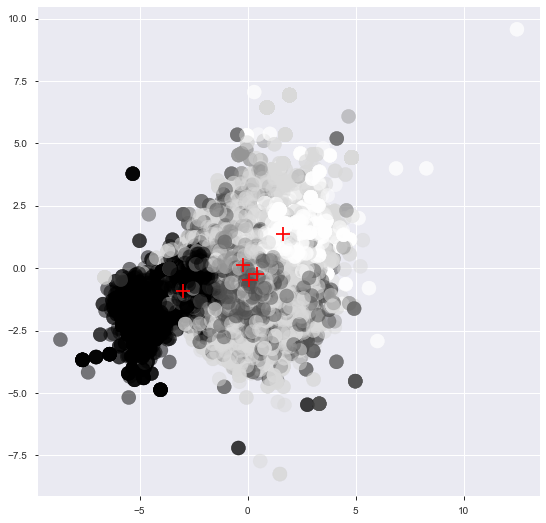

In [247]:
# Графики полученных кластеров
X = np.asarray(list(data['description'].values) )

y_pred = kmeans.labels_.astype(np.int)
colors = ("red", "green", "blue", "yellow")
plt.rcParams['figure.figsize'] = 9,9
plt.scatter(X[:, 0], X[:, 1], c=y_pred, s=200, alpha=.5)
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], c='red', s=200, marker='+')
plt.show()

In [248]:
data.drop('description', axis=1, inplace=True, errors='ignore')

In [251]:
cat_features_ids = ['bodyType', 'brand', 'color', 'fuelType', 
                    'model_name', 'vehicleTransmission',
                    'pts', 'privod', 'wheel', 'state', 'descr_labels']

In [252]:
# data[data['description'].apply(len)<30].index

# DUMMY

In [253]:
# for_dummy_cols = ['fuelType',  'vehicleTransmission', 'pts']
# data = pd.get_dummies(data, columns=for_dummy_cols, drop_first=False)

In [254]:
data['equipment_dict'] = data['equipment_dict'].apply(lambda x: ['not_specified'] if len(x)==0 else x)
equip_set = set()
data.equipment_dict.apply(lambda x: equip_set.update(x))
equips_df = pd.DataFrame(columns=list(equip_set), data=np.zeros((data.shape[0], len(equip_set))), dtype=int)
data = pd.concat([equips_df, data], axis=1, join='inner')
for i in range(data.shape[0]):
    for equip in data.equipment_dict.iloc[i]:
        data[equip].iloc[i] = 1

data.drop('equipment_dict', axis=1, inplace=True, errors='ignore')

# Normalize

In [255]:
# scaler = StandardScaler().fit(data.mileage)
data[['mileage', 'enginePower']] = StandardScaler().fit_transform(data[['mileage', 'enginePower']].values)

# Подготовка данных для модели

In [256]:
# data.to_csv('data_for_stacking.csv')

In [257]:
# data.drop('sell_id', axis=1, inplace=True, errors='ignore')

X = data.query('sample == 1').drop(['sample'], axis=1)
y = X['price']

X.drop('price', axis=1, inplace=True, errors='ignore')
X_sub = data.query('sample == 0').drop(['sample', 'price'], axis=1)

In [258]:
VAL_SIZE=0.20
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=VAL_SIZE, shuffle=True, random_state=RANDOM_SEED)

In [259]:
y_train = np.log(y_train)
y_test = np.log(y_test)

In [260]:
# CHANGEs COMMENT
changes_comment = 'depth12 LR0.05'

In [261]:
# data.drop(data[data.duplicated(subset='sell_id', keep='first')].index, inplace=True)

In [262]:
print(data.duplicated(subset='sell_id', keep='first').value_counts())
data.to_csv('data_for_stacking.csv')

False    194800
True      14747
dtype: int64


# MODEL

In [263]:
# CATBOOST

catboost_params = {
    'iterations': 5000,
    'learning_rate': 0.06,
    'depth': 12,
    'random_seed': RANDOM_SEED,
    'eval_metric': 'MAPE',
    'custom_metric': ['R2', 'MAE'],
    'l2_leaf_reg': 1

}

ITERATIONS = 5000
LR         =  0.05775539388456 # 0.08343057119918101 #0.09399760402267439 #0.1
depth = 12 # 4 # 8 #12

In [264]:
train_pool = Pool(
    X_train,
    y_train,
    cat_features=cat_features_ids,
) 
test_pool = Pool(
    X_test,
    y_test,
    cat_features=cat_features_ids,
)

model = CatBoostRegressor(iterations = catboost_params['iterations'],
                          learning_rate = catboost_params['learning_rate'],
                          random_seed = RANDOM_SEED,
                          eval_metric=catboost_params['eval_metric'],
                          custom_metric=catboost_params['custom_metric'],
                          l2_leaf_reg=catboost_params['l2_leaf_reg'],
                          depth=catboost_params['depth'],
                          metric_period=catboost_params['depth'],
                          od_type='Iter',
                          od_wait=20,
                          rsm=0.2,
                          devices='GPU'
                         )
model.fit(train_pool,
         eval_set=test_pool,
         verbose_eval=catboost_params['depth']*4,
         use_best_model=True,
         plot=False
         )

0:	learn: 0.0690415	test: 0.0689756	best: 0.0689756 (0)	total: 416ms	remaining: 34m 40s
48:	learn: 0.0133039	test: 0.0135450	best: 0.0135450 (48)	total: 15.1s	remaining: 25m 21s
96:	learn: 0.0109898	test: 0.0114944	best: 0.0114944 (96)	total: 30.8s	remaining: 25m 58s
144:	learn: 0.0101921	test: 0.0108952	best: 0.0108952 (144)	total: 48.4s	remaining: 27m
192:	learn: 0.0096367	test: 0.0105135	best: 0.0105135 (192)	total: 1m 6s	remaining: 27m 39s
240:	learn: 0.0091502	test: 0.0101958	best: 0.0101958 (240)	total: 1m 23s	remaining: 27m 23s
288:	learn: 0.0087084	test: 0.0099281	best: 0.0099281 (288)	total: 1m 38s	remaining: 26m 39s
336:	learn: 0.0083748	test: 0.0097390	best: 0.0097390 (336)	total: 1m 53s	remaining: 26m 12s
384:	learn: 0.0080904	test: 0.0095724	best: 0.0095724 (384)	total: 2m 9s	remaining: 25m 46s
432:	learn: 0.0078034	test: 0.0094202	best: 0.0094202 (432)	total: 2m 24s	remaining: 25m 23s
480:	learn: 0.0075482	test: 0.0093011	best: 0.0093011 (480)	total: 2m 39s	remaining: 24m

<AxesSubplot:ylabel='Feature Id'>

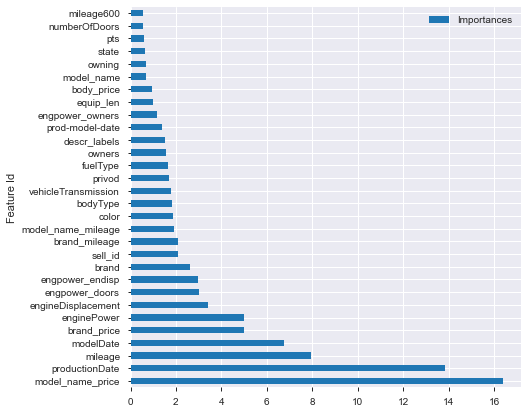

In [265]:
plt.rcParams['figure.figsize'] = 7,7
imp_features = model.get_feature_importance(prettified=True)[:30]
imp_features.sort_values(by='Importances',inplace=True, ascending=False)
imp_features.set_index('Feature Id', inplace=True)
imp_features.plot(kind='barh')

In [266]:
predict = model.predict(X_test)

predict = np.e ** predict
y_test = np.e ** y_test

# оцениваем точность
MAPE = f'{(mape(y_test, predict))*100:0.4f}'
print(f"Точность модели по метрике MAPE: {MAPE}%")

Точность модели по метрике MAPE: 9.1993%


In [267]:
predict_1 = np.round(predict // 10000) * 10000
MAPE10k = f'{(mape(y_test, predict_1))*100:0.4f}'
print(f"Точность модели по метрике MAPE: {MAPE10k}%")

Точность модели по метрике MAPE: 9.0726%


In [268]:
predict_2 = predict // 1000 * 1000
MAPE = f'{(mape(y_test, predict_2))*100:0.4f}'
print(f"Точность модели по метрике MAPE: {MAPE}%")

Точность модели по метрике MAPE: 9.1738%


In [269]:
import winsound
freq = 2000 # Set frequency To 2500 Hertz
dur = 700 # Set duration To 1000 ms == 1 second
winsound.Beep(freq, dur) 

# SUBMISSION

In [270]:
MAPE10k = MAPE
print('update sub version')
version_ser = pd.read_csv('kaggle/submissions_kaggle/sub_version.csv', index_col=0)
new_version = version_ser['sub_version'].loc[0] + 1
new_version_list = pd.DataFrame({'sub_version': new_version, 'sub_dt' : pd.Timestamp.today(), 'MAPE': MAPE , 'MAPE10k': MAPE10k, 'comment': changes_comment}, index =[0])
version_ser = pd.concat([new_version_list, version_ser[:]]).reset_index(drop = True)
version_ser.to_csv('kaggle/submissions_kaggle/sub_version.csv', index='index')

update sub version


In [271]:
pd.set_option('display.expand_frame_repr', False)
print(version_ser.head(10))

   sub_version                      sub_dt     MAPE  MAPE10k                               comment
0          112  2020-12-19 00:30:51.579071   9.1738   9.1738                        depth12 LR0.05
1          111  2020-12-16 19:30:33.759460 9.473400 9.473400                        depth12 LR0.05
2          110  2020-12-16 18:44:33.246667 3.120300 3.120300                        depth12 LR0.05
3          109  2020-12-16 13:49:08.348679 9.566100 9.478700                        depth12 LR0.05
4          108  2020-12-14 19:31:03.662375 9.560800 9.454200                        depth12 LR0.05
5          107  2020-12-13 20:42:06.725556 9.477200 9.339600                        depth12 LR0.05
6          106  2020-12-13 20:03:45.517970 9.209000 9.119300                        depth12 LR0.05
7          105  2020-12-10 12:14:38.844103 9.234600 9.150700  depth12 LR0.05 add-EqupLen dropEquip
8          104  2020-12-10 01:07:59.229699 9.258600 9.169300  depth12 LR0.05 add-EqupLen dropEquip
9         

In [272]:
predict_submission = model.predict(X_sub)
predict_submission = np.e ** predict_submission
predict_submission = predict_submission // 10000 * 10000
sample_submission['price'] = predict_submission
sample_submission.to_csv(f'kaggle\submissions_kaggle\submission_{new_version}.csv', index=False)
sample_submission.head(5)

,sell_id,price
0,1100575026,630000.000000
1,1100549428,1010000.000000
2,1100658222,880000.000000
3,1100937408,780000.000000
4,1101037972,720000.000000


In [284]:
data.to_csv('data_for_stacking.csv')

# Изучаем ошибки

In [274]:
# pd.DataFrame(columns=['predict', 'true'] , data=[predict, y_test.values])
errors = {'index': y_test.index,'true': y_test.values, 'predict': predict, 'diffr': (y_test.values - predict)}
errors = pd.DataFrame(errors)
errors['diffr'].mean()

20024.73079258939

In [275]:
errors[abs(errors['diffr']).between(500_000, 70000_000)].true.mean()
abs(errors['diffr']).sort_values(ascending=False).head(20)

3752    65965849.334631
14077   63315500.973179
28476   62154806.641287
160     38407909.565871
26069   16628654.148059
2970     9443389.468042
23885    8463676.984226
21599    8057261.105780
13972    6649586.276603
9798     6457747.576801
25775    5329309.683136
5108     5323553.779765
19089    5281822.488816
25185    5279651.368113
19888    5183379.244172
28109    5120299.637429
6715     4845745.592221
14275    4766931.990519
31521    4576528.083142
33651    4477390.540065
Name: diffr, dtype: float64

In [276]:
errors[abs(errors['diffr']).between(500_000, 70000_000)]['diffr'].mean()

795244.9639361999

In [277]:
errors[errors['diffr']>600_000][['true','diffr']].mean()

true    9738013.170391
diffr   2143887.760768
dtype: float64

(array([-2.5,  0. ,  2.5,  5. ,  7.5, 10. , 12.5, 15. , 17.5, 20. ]),
 [Text(-2.5, 0, ''),
  Text(0.0, 0, '(15000.0, 2667755.102]'),
  Text(2.5, 0, ''),
  Text(5.0, 0, '(13278775.51, 15931530.612]'),
  Text(7.5, 0, ''),
  Text(10.0, 0, '(26542551.02, 29195306.122]'),
  Text(12.5, 0, ''),
  Text(15.0, 0, '(55722857.143, 58375612.245]'),
  Text(17.5, 0, ''),
  Text(20.0, 0, '')])

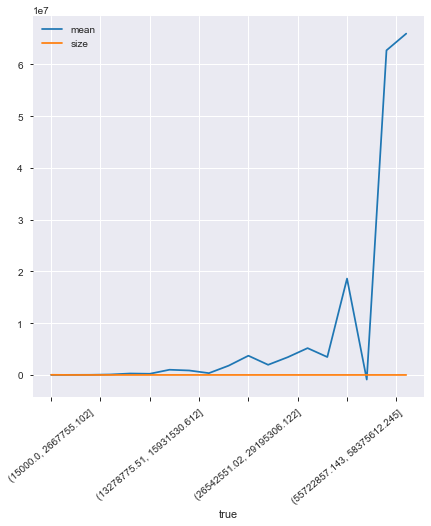

In [278]:
bins = np.linspace(errors.true.min(), errors.true.max(), 50)
groups = errors.groupby(pd.cut(errors.true, bins))


# groups.mean()
plt.rcParams['figure.figsize'] = 7,7

groups[['diffr']].agg([np.mean, np.size]).dropna().reset_index().plot(x='true', y='diffr')
plt.xticks(rotation=40)
# errors.groupby(by='diffr').mean()

In [279]:
train = pd.read_csv(input_folder + 'parsed_data_1.csv')
train.dropna(subset=['price'], inplace=True)
# Почистим от дубликатов

# print(data.sell_id.value_counts())
print('Размер до очистки от дублей', train.shape)
train.drop_duplicates(subset ="sell_id", keep = False, inplace = True)
print('Размер после очистки от дублей', train.shape)

test = pd.read_csv('kaggle/test.csv')
# test.dropna(subset=['price'], inplace=True)

sample_submission = pd.read_csv('kaggle/sample_submission.csv')

df_train = train
df_test = test
# ВАЖНО! дря корректной обработки признаков объединяем трейн и тест в один датасет
df_train['sample'] = 1 # помечаем где у нас трейн
df_test['sample'] = 0 # помечаем где у нас тест

data_errors = df_test.append(df_train, sort=False).reset_index(drop=True) # объединяем
data_errors.columns = ['bodyType', 'brand', 'car_url', 'color', 'complectation_dict',
       'description', 'engineDisplacement', 'enginePower', 'equipment_dict',
       'fuelType', 'image', 'mileage', 'modelDate', 'model_info', 'model_name',
       'name', 'numberOfDoors', 'parsing_unixtime', 'priceCurrency',
       'productionDate', 'sell_id', 'super_gen', 'vehicleConfiguration',
       'vehicleTransmission', 'vendor', 'owners', 'owning', 'pts', 'privod', 'wheel', 
       'state', 'customs', 'sample', 'Unnamed: 0','seller_name', 'price']

Размер до очистки от дублей (88297, 29)
Размер после очистки от дублей (86429, 29)


<AxesSubplot:>

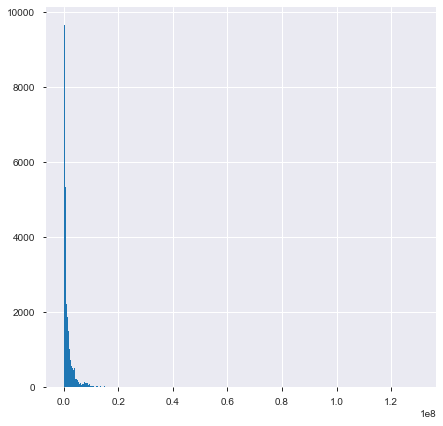

In [280]:
data_errors['price'].hist(bins=1000)

In [281]:
f1_list = list(X_sub.columns)

In [282]:
x_list = ['hcc', 'power-child-locks-rear-doors', 'folding-front-passenger-seat', 'steering-wheel-gear-shift-paddles', 'drowsy-driver-alert-system', 'airbag-side', 'third-rear-headrest', 'multi-wheel', 'entertainment-system-for-rear-seat-passengers', 'panorama-roof', 'seats-9', 'rear-seats-heat', 'front-seat-support', '19-inch-wheels', 'black-roof', '345', 'armored', '3FB', 'reduce-spare-wheel', '881', 'light-cleaner', 'airbag-6', 'vsm', 'fabric-seats', 'airbrush', 'PW1', 'airbag-rear-side', 'air-suspension', 'audiosystem-tv', '16-inch-wheels', 'airbag-passenger', 'light-interior', 'seat-transformation', '239', 'traffic-sign-recognition', 'wheel-configuration3', 'gbo', 'massage-seats', 'seats-2', 'feedback-alarm', 'PRD', '6R1', '401', '1N1', 'audiopreparation', 'turnbuckle', 'PCG', 'electro-trunk', '246', 'PL2', 'knee-airbag', '51U', 'voice-recognition', 'leather-gear-stick', '448', 'aux', 'lock', '242', '872', 'wheel-configuration2', 'driver-seat-support', 'B63', '23-inch-wheels', '27-inch-wheels', 'U22', '18-inch-wheels', 'adaptive-light', '12v-socket', 'P17', 'rear-camera', 'driver-seat-memory', 'electro-window-front', 'park-assist-f', 'heated-wash-system', '443', 'U25', 'seat-memory', '4A3', '17-inch-wheels', 'servo', 'climate-control-1', 'auto-mirrors', '3L5', 'PCH', 'spare-wheel', 'velvet-seats', '632', 'engine-proof', '68BF', 'laser-lights', 'RAB', 'volume-sensor', 'parktronik', 'ashtray-and-cigarette-lighter', 'night-vision', 'E0P', 'collision-prevention-assist', '086GC', '776', 'S7N', '414', '3S1', 'electro-window-all', '03B', 'bas', 'front-seats-heat', 'front-seats-heat-vent', 'wireless-charger', 'body-kit', 'e-adjustment-wheel', 'H06', 'R66', 'duo-body-color', '4R3', 'auto-cruise', '3Q6', 'electro-mirrors', 'electro-seat', 'led-lights', 'windcleaner-heat', '540', 'folding-tables-rear', '9P5', 'music-super', 'passenger-seat-manual', '9T1', '475', 'sport-suspension', 'isofix', 'roof-rails', 'blind-spot', '431', 'UI4', 'automatic-lighting-control', '6XD', '4UE', '4R2', '871', '927', 'immobiliser-not-standard', 'airbag-2', 'PB0', 'multizone-climate-control', 'wheel-configuration1', '9S6', 'wheel-power', 'door-sill-panel', 'android-auto', 'tyre-pressure', 'electronic-gage-panel', '840', 'climate-control-3', '270', 'decorative-interior-lighting', 'esp', 'adj-pedals', 'airbag-curtain', '7X5', 'apple-carplay', 'alcantara', '989', '086EG', '14U', 'lane-keeping-assist', '551', 'asr', '6XE', '4I2', '772', '351', 'start-stop-function', 'start-button', 'B16', '6E3', '313', 'activ-suspension', '364', 'passenger-seat-electric', 'DZ9', '3NZ', 'dark-interior', 'PA1', 'rain-sensor', '873', 'leather', 'wheel-memory', 'N4M', 'PQ9', '033IN', 'not_specified', 'tinted-glass', '15-inch-wheels', '9VS', '086FA', 'driver-seat-manual', '824', '728', '889', 'PN0', 'sport-pedals', 'P31', '234', 'sport-seats', '274', 'seats-4', 'airbag-driver', 'paint-metallic', '9S3', '3B3', '8T6', 'electro-rear-seat', 'drl', '7Y4', 'hatch', '3PB', 'power-latching-doors', 'navigation', 'driver-seat-updown', 'computer', 'xenon', '883', 'body-mouldings', 'L5C', 'passenger-seat-memory', 'seats-7', 'seats-heat', 'WVA', 'drive-mode-sys', 'U09', '670', '4X4', '513', '500', '810', 'ya-auto', 'wheel-leather', 'PRG', '440', 'programmed-block-heater', '14-inch-wheels', 'audiosystem', 'keyless-entry', 'audiosystem-cd', 'P29', 'seats-8', '220v-socket', '249', '25-inch-wheels', '608', 'roller-blinds-for-rear-side-windows', '531', 'easy-trunk-opening', 'laminated-safety-glass', 'cooling-box', '61U', 'immo', 'R01', '501', '597', 'usb', '360-camera', '20-inch-wheels', 'glonass', 'rear-seat-heat-vent', 'airbag-4', '6XF', 'PRA', '21-inch-wheels', 'advanced-frontlighting-system', '301', '6NQ', 'climate-control', 'windscreen-heat', '066AC', 'bluetooth', '9AB', 'alloy-wheel-disks', '8T2', 'halogen', 'seats-6', '7B2', 'steel-wheels', '7AA', 'passenger-seat-updown', 'KA2', 'eco-leather', '24-inch-wheels', '235', 'mirrors-heat', 'RDIF09', 'light-sensor', '8RM', 'wheel-heat', '17U', 'seats-5', '218', '42D', '033GQ', 'auto-park', 'front-centre-armrest', 'isofix-front', 'remote-engine-start', '882', 'PX2', '4D3', 'condition', 'driver-seat-electric', '367', '807', '041CZ', 'front-camera', 'abs', 'projection-display', '228', 'third-row-seats', 'P44', '12-inch-wheels', 'ptf', '68BD', '22-inch-wheels', 'CJ4', 'electro-window-back', 'climate-control-2', '2C5', 'cruise-control', 'alarm', '16U', '13-inch-wheels', 'combo-interior', 'dha', '9R1', '357', 'park-assist-r', '4UC', 'PNQ', 'RVR', 'high-beam-assist', 'roller-blind-for-rear-window', 'bodyType', 'brand', 'color', 'engineDisplacement', 'enginePower', 'fuelType', 'mileage', 'modelDate', 'model_name', 'numberOfDoors', 'parsing_unixtime', 'productionDate', 'sell_id', 'vehicleTransmission', 'owners', 'owning', 'pts', 'privod', 'wheel', 'state', 'price', 'mileage600', 'engpower_doors', 'engpower_endisp', 'engpower_owners', 'prod-model-date', 'car_used', 'brand_price', 'body_price', 'model_name_price', 'brand_mileage', 'model_name_mileage', 'equip_len', 'descr_labels']

In [283]:
set(x_list) - set(f1_list)

{'price'}

KeyError: 'price'